### El fichero Provincias contiene información socio-económica de las provincias españolas. (Se han modificado los nombres de las variables). Para reducir el número de variables e intentar encontrar relaciones, tanto entre variables como entre provincias, realizar los siguientes apartados.

### 1. Calcular la matriz de correlaciones, y su representación gráfica ¿Cuáles son las variables más correlacionadas de forma inversa?

In [37]:
install.packages("readxl")
install.packages("rmarkdown")
install.packages("knitr")
install.packages("pastecs")
install.packages("ggplot2")
install.packages("corrplot")
install.packages("factoextra")
install.packages("FactoMineR")
install.packages("forecast")
install.packages("RColorBrewer")
install.packages("corrplot")
install.packages("stats")
install.packages("lattice")
install.packages("cluster")
install.packages("heatmaply")
install.packages("NbClust")

Warning message:
"package 'readxl' is in use and will not be installed"
Warning message:
"package 'rmarkdown' is in use and will not be installed"
Warning message:
"package 'knitr' is in use and will not be installed"
Warning message:
"package 'pastecs' is in use and will not be installed"
Warning message:
"package 'ggplot2' is in use and will not be installed"
Warning message:
"package 'corrplot' is in use and will not be installed"
Warning message:
"package 'factoextra' is in use and will not be installed"
Warning message:
"package 'FactoMineR' is in use and will not be installed"
Warning message:
"package 'forecast' is in use and will not be installed"
Warning message:
"package 'RColorBrewer' is in use and will not be installed"
Warning message:
"package 'corrplot' is in use and will not be installed"
Warning message:
"package 'stats' is in use and will not be installed"
Warning message:
"package 'lattice' is in use and will not be installed"
Warning message:
"package 'cluster' is i

In [38]:
library(readxl)
library(rmarkdown)
library(knitr)
library(forecast)
library(RColorBrewer)
library(corrplot)
library(pastecs)
library(stats)
library(lattice)
library(readxl)
library(cluster)
library(ggplot2)#para representAR
library(heatmaply)#representar m apas de calor
library(factoextra)#PARA DIBIJAR EL RESULTADO del analisis cluster
library(FactoMineR)
library(NbClust)#nº optimo datos en nuestro con junto de datos


In [39]:
DATOS_provincias<- read_excel("C:/Users/Provincias.xlsx")
df_datos<-as.data.frame(DATOS_provincias)
rownames(df_datos)<-df_datos[,1]
dat_provincias<-df_datos[,-1]
head(dat_provincias)

,Poblacion,Mortalidad,Natalidad,IPC,NumEmpresas,Industria,Construccion,CTH,Infor,AFS,APT,TasaActividad,TasaParo,Ocupados,PIB,CANE,TVF,VS
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Albacete,396987,9.41,9.02,101.819,26701,3332,3428,11111,189,624,3278,57.72,23.28,144.8,7235991,20888,215948,30244
Alicante,1868438,8.00,8.52,102.309,130438,9992,17418,52720,1851,2745,19865,58.21,23.39,687.1,32139347,25968,1274096,326705
Almería,701688,6.91,11.41,101.454,40327,2191,5388,18184,366,944,5840,60.63,31.08,234.4,11909684,22945,395086,72486
Álava,321932,7.72,10.26,102.743,19548,2048,2669,7557,323,354,3341,57.86,13.33,133.0,10716021,3691,155767,9791
Asturias,1061756,12.16,6.26,102.070,67451,3496,8435,28045,787,1445,10598,51.42,16.97,389.0,21770433,23910,613905,73250
Badajoz,690929,9.54,8.96,101.036,39640,3059,4599,18420,332,948,5235,56.00,29.63,224.6,10581366,37438,372493,49441


In [40]:
matriz_corr<-cor(dat_provincias)
matriz_corr
#knitr::kable(matriz_corr, digits =2, caption = "correlaciones")

,Poblacion,Mortalidad,Natalidad,IPC,NumEmpresas,Industria,Construccion,CTH,Infor,AFS,APT,TasaActividad,TasaParo,Ocupados,PIB,CANE,TVF,VS
Poblacion,1.000000000,-0.34359937,0.11445938,0.33483095,0.99453328,0.96458267,0.98416996,0.996110046,0.94453881,0.99220221,0.980028733,0.33414642,0.009850323,0.99550003,0.980976869,0.097205159,0.99071731,0.56653976
Mortalidad,-0.343599371,1.00000000,-0.73652925,0.18846127,-0.30927237,-0.28184861,-0.29590918,-0.329333667,-0.25983697,-0.30518551,-0.295728912,-0.73348067,-0.463972419,-0.32761124,-0.295604063,0.016432872,-0.33230307,-0.24903743
Natalidad,0.114459382,-0.73652925,1.00000000,-0.25391157,0.10501778,0.09274529,0.08874307,0.101444356,0.11454957,0.10467705,0.113268704,0.47242170,0.383038405,0.11174153,0.113829452,-0.123091063,0.08444871,-0.02766720
IPC,0.334830949,0.18846127,-0.25391157,1.00000000,0.36475679,0.41971227,0.39988432,0.362397751,0.30044315,0.32267001,0.332616084,0.08970542,-0.582234824,0.35818832,0.355394973,-0.191207090,0.34095210,0.19117175
NumEmpresas,0.994533276,-0.30927237,0.10501778,0.36475679,1.00000000,0.96870767,0.99458429,0.993878918,0.96270044,0.99263984,0.990582046,0.33232416,-0.056232280,0.99834423,0.990277980,0.044834740,0.98226824,0.54044321
Industria,0.964582668,-0.28184861,0.09274529,0.41971227,0.96870767,1.00000000,0.96613670,0.976499325,0.88925300,0.94716931,0.934149162,0.29177908,-0.080353746,0.96153241,0.942717675,0.123766207,0.96533176,0.56716093
Construccion,0.984169957,-0.29590918,0.08874307,0.39988432,0.99458429,0.96613670,1.00000000,0.985702825,0.95796587,0.98427617,0.984579370,0.34122871,-0.109170963,0.99320060,0.985293522,0.029744519,0.97574923,0.55654176
CTH,0.996110046,-0.32933367,0.10144436,0.36239775,0.99387892,0.97649932,0.98570283,1.000000000,0.92902236,0.98333802,0.971043919,0.32593482,-0.007188617,0.99112993,0.971695960,0.093619748,0.99103137,0.57820586
Infor,0.944538806,-0.25983697,0.11454957,0.30044315,0.96270044,0.88925300,0.95796587,0.929022359,1.00000000,0.96891562,0.989614166,0.30815427,-0.108863576,0.96445717,0.985447530,-0.066339831,0.91150808,0.40901985
AFS,0.992202208,-0.30518551,0.10467705,0.32267001,0.99263984,0.94716931,0.98427617,0.983338024,0.96891562,1.00000000,0.991606815,0.31749496,-0.031727168,0.99462721,0.989333140,0.085739618,0.97871645,0.54055564


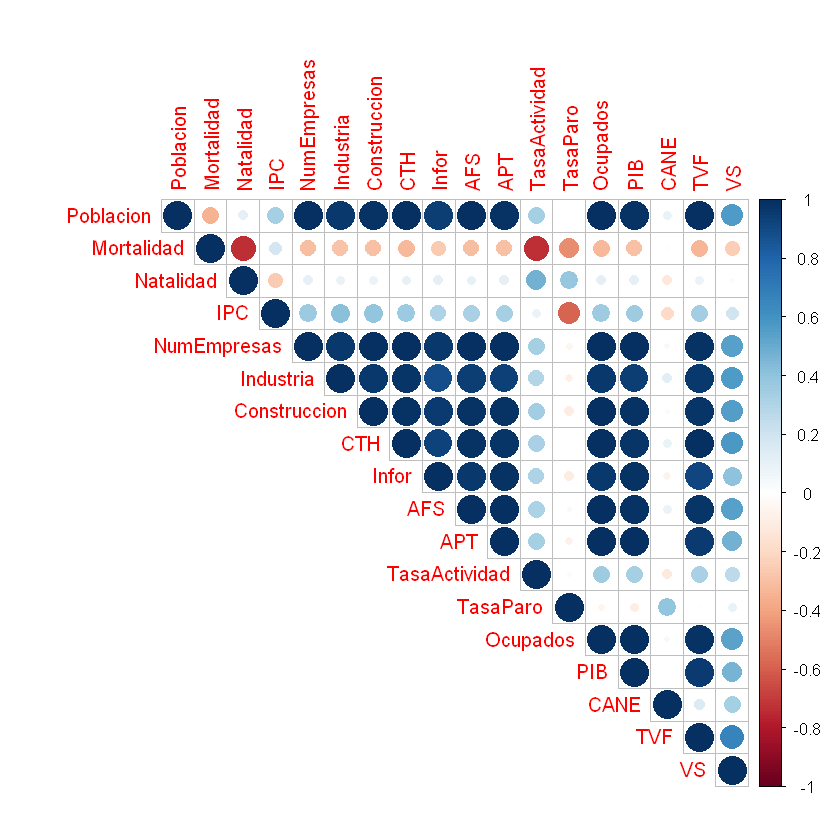

In [41]:
corrplot(matriz_corr, type="upper", col= NULL)

Las variables más corelacionadas de forma inversa son Mortalidad y tasaActividad(-0,73) y IPC y Tasaparo(-0.58)

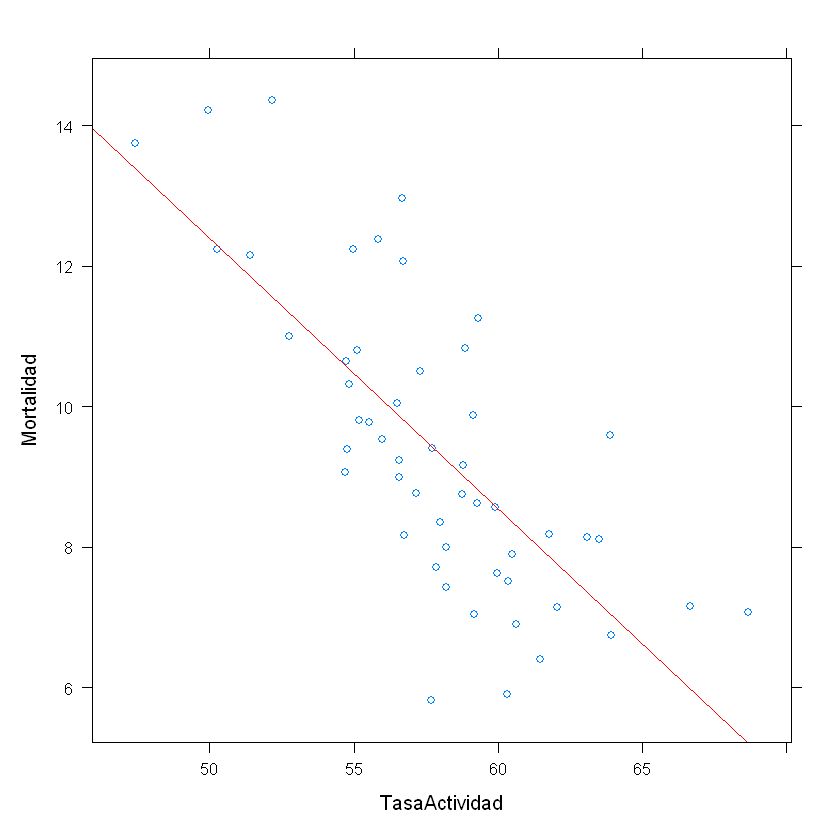

In [42]:
#Se puede ver en los gráficos de dispersión entre ellas
#con xyplot
xyplot(Mortalidad~TasaActividad,data=dat_provincias, type = c("p","r"), col.line = "red")


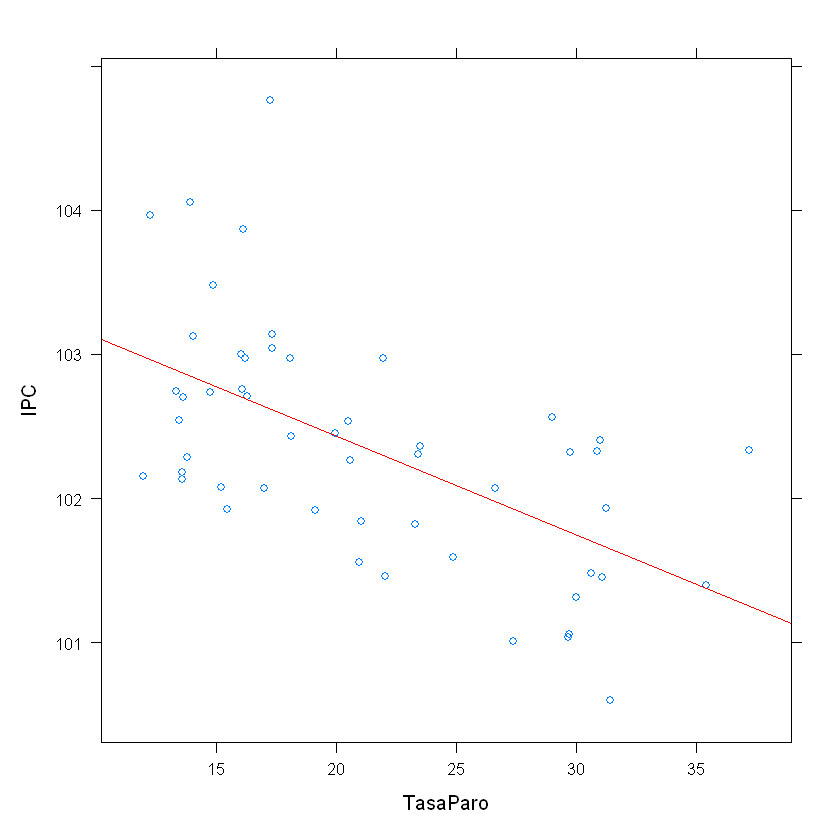

In [43]:
xyplot(IPC~TasaParo,data=dat_provincias, type = c("p","r"), col.line = "red")

### 2. Realizar un análisis de componentes principales sobre la matriz de correlaciones, calculando 7 componentes. Estudiar los valores de los autovalores obtenidos y las gráficas que los resumen. ¿Cuál es el número adecuado de componentes?

In [44]:
fit<-PCA(dat_provincias,scale.unit=TRUE,ncp=7,graph=TRUE)
eig<-get_eigenvalue(fit)
eig
#knitr::kable(eig, digits =2, caption ="autovalores")


Warning message:
"ggrepel: 11 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


,eigenvalue,variance.percent,cumulative.variance.percent
Dim.1,1.146640e+01,6.370222e+01,63.70222
Dim.2,2.560508e+00,1.422504e+01,77.92726
Dim.3,1.634097e+00,9.078315e+00,87.00558
Dim.4,9.340488e-01,5.189160e+00,92.19474
Dim.5,4.565320e-01,2.536289e+00,94.73102
Dim.6,4.143630e-01,2.302017e+00,97.03304
Dim.7,3.071743e-01,1.706524e+00,98.73957
Dim.8,1.166154e-01,6.478631e-01,99.38743
Dim.9,7.309913e-02,4.061063e-01,99.79353
Dim.10,2.034496e-02,1.130275e-01,99.90656


Con los 4 primeros autovalores ya explicamos el 92.19% de la varianza de las variables .Con 3 no se llega al valor de 90%, por lo que se plantea que sean 4 dimensiones.

Los autovectores asociados a dihos autovalores nos dan los coeficientes de la combinación lineal con la que se construyen las componentes.

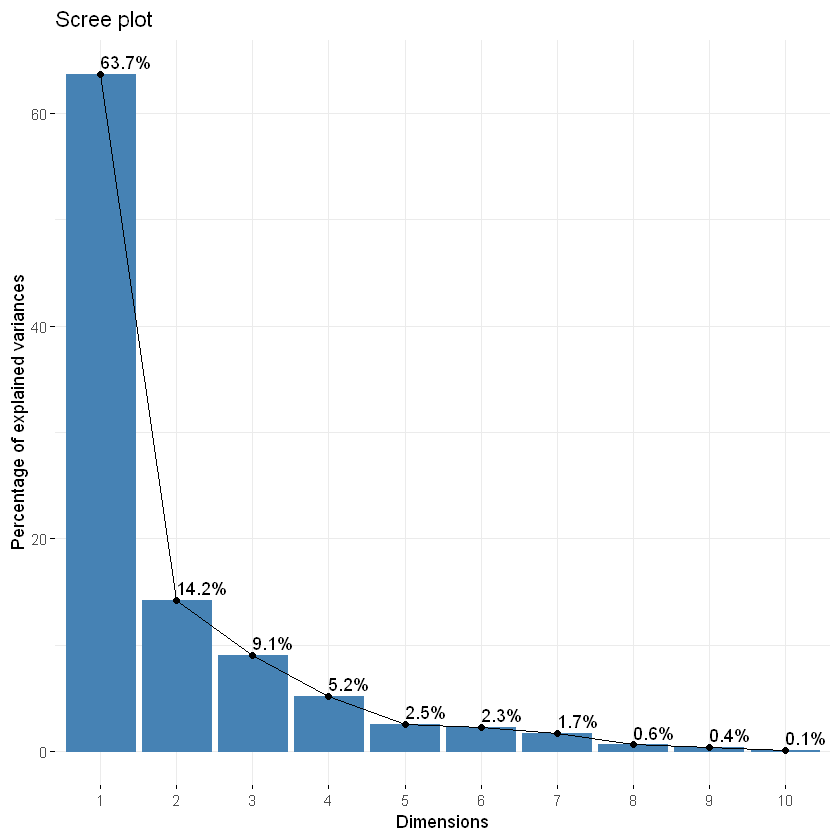

In [45]:
fviz_eig(fit,addlabels=TRUE)

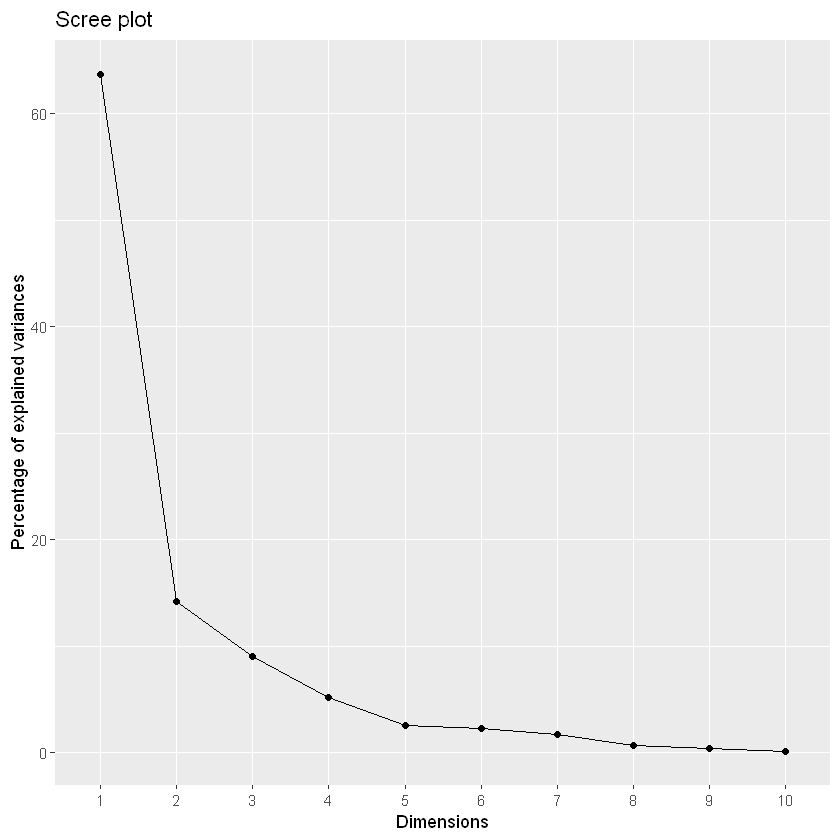

In [46]:
fviz_eig(fit,geom="line")+theme_grey()

### 3.- Hacer de nuevo el análisis sobre la matriz de correlaciones pero ahora indicando el número de componentes principales que hemos decidido retener (Que expliquen aproximadamente el 90%). Sobre este análisis contestar los siguientes apartados

### a. Mostrar los coeficientes para obtener las componentes principales ¿Cuál es la expresión para calcular la primera Componente en función de las variables originales?


In [47]:
fit<-PCA(dat_provincias,scale.unit=TRUE,ncp=4,graph=TRUE)

Warning message:
"ggrepel: 11 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


In [48]:
eig<-get_eigenvalue(fit)
knitr::kable(eig, digits =2, caption ="autovalores")




Table: autovalores

|       | eigenvalue| variance.percent| cumulative.variance.percent|
|:------|----------:|----------------:|---------------------------:|
|Dim.1  |      11.47|            63.70|                       63.70|
|Dim.2  |       2.56|            14.23|                       77.93|
|Dim.3  |       1.63|             9.08|                       87.01|
|Dim.4  |       0.93|             5.19|                       92.19|
|Dim.5  |       0.46|             2.54|                       94.73|
|Dim.6  |       0.41|             2.30|                       97.03|
|Dim.7  |       0.31|             1.71|                       98.74|
|Dim.8  |       0.12|             0.65|                       99.39|
|Dim.9  |       0.07|             0.41|                       99.79|
|Dim.10 |       0.02|             0.11|                       99.91|
|Dim.11 |       0.01|             0.05|                       99.96|
|Dim.12 |       0.00|             0.02|                       99.98|
|Dim.13 |   

In [49]:
knitr::kable(fit$svd$V, digits =3,caption = "Autovectores")



Table: Autovectores

|       |       |       |       |
|------:|------:|------:|------:|
|  0.294|  0.002|  0.050| -0.053|
| -0.106| -0.527|  0.189| -0.161|
|  0.041|  0.495| -0.271| -0.110|
|  0.110| -0.365| -0.262|  0.435|
|  0.294| -0.026|  0.008| -0.069|
|  0.286| -0.045|  0.046|  0.023|
|  0.293| -0.045| -0.012| -0.026|
|  0.293| -0.011|  0.049| -0.028|
|  0.282| -0.042| -0.065| -0.222|
|  0.292| -0.016|  0.040| -0.092|
|  0.291| -0.029| -0.028| -0.142|
|  0.114|  0.331| -0.363|  0.463|
| -0.014|  0.462|  0.387| -0.220|
|  0.294| -0.017|  0.002| -0.060|
|  0.291| -0.036| -0.037| -0.134|
|  0.018|  0.096|  0.657|  0.278|
|  0.292| -0.002|  0.100|  0.044|
|  0.172|  0.048|  0.290|  0.567|

$CP1= 0.294 Población^*- 0.106 Mortalidad^* + 0.041 Natalidad^* +.....+ 0.172VS^*$  

Estos con los componentes principales.
Estos con los coeficientes de la expresión para calcular 
la primera componente en función de las variables originales.

### b. Mostar una tabla con las correlaciones de las Variables con las Componentes Principales. Para cada Componente indicar las variables con las que está más correlacionada

In [50]:
var<-get_pca_var(fit)
knitr::kable(var$cor, digits = 2,caption = " Correlaciones de la CP con las variables")



Table:  Correlaciones de la CP con las variables

|              | Dim.1| Dim.2| Dim.3| Dim.4|
|:-------------|-----:|-----:|-----:|-----:|
|Poblacion     |  0.99|  0.00|  0.06| -0.05|
|Mortalidad    | -0.36| -0.84|  0.24| -0.16|
|Natalidad     |  0.14|  0.79| -0.35| -0.11|
|IPC           |  0.37| -0.58| -0.34|  0.42|
|NumEmpresas   |  1.00| -0.04|  0.01| -0.07|
|Industria     |  0.97| -0.07|  0.06|  0.02|
|Construccion  |  0.99| -0.07| -0.02| -0.03|
|CTH           |  0.99| -0.02|  0.06| -0.03|
|Infor         |  0.95| -0.07| -0.08| -0.21|
|AFS           |  0.99| -0.03|  0.05| -0.09|
|APT           |  0.98| -0.05| -0.04| -0.14|
|TasaActividad |  0.39|  0.53| -0.46|  0.45|
|TasaParo      | -0.05|  0.74|  0.50| -0.21|
|Ocupados      |  1.00| -0.03|  0.00| -0.06|
|PIB           |  0.99| -0.06| -0.05| -0.13|
|CANE          |  0.06|  0.15|  0.84|  0.27|
|TVF           |  0.99|  0.00|  0.13|  0.04|
|VS            |  0.58|  0.08|  0.37|  0.55|

**La componente 1** está más correlacionada postivamente con:NumEmpresas, Ocupados y luego Construccion,CTH, AFS,PIb, TVF 
1-La componente 1 está más correlacionada negativamente con:Mortalidad

**La componente 2** está más correlacionada postivamente con:Natalidad, tasaParo
2-La componente 2 está más correlacionada negativamente con:Mortalidad,IPC

**La componente 3** está más correlacionada postivamente con:CANE,TasaParo
3-La componente 3 está más correlacionada negativamente con:Nataliad,IPC

**La componente 4** está más correlacionada postivamente con:VS, tasaactividad
4-La componente 4 está más correlacionada negativamente con:Infor, tasaParo

### c. Comentar los gráficos que representan las variables en los planos formados por las componentes, intentando explicar lo que representa cada componente

Warning message:
"ggrepel: 11 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


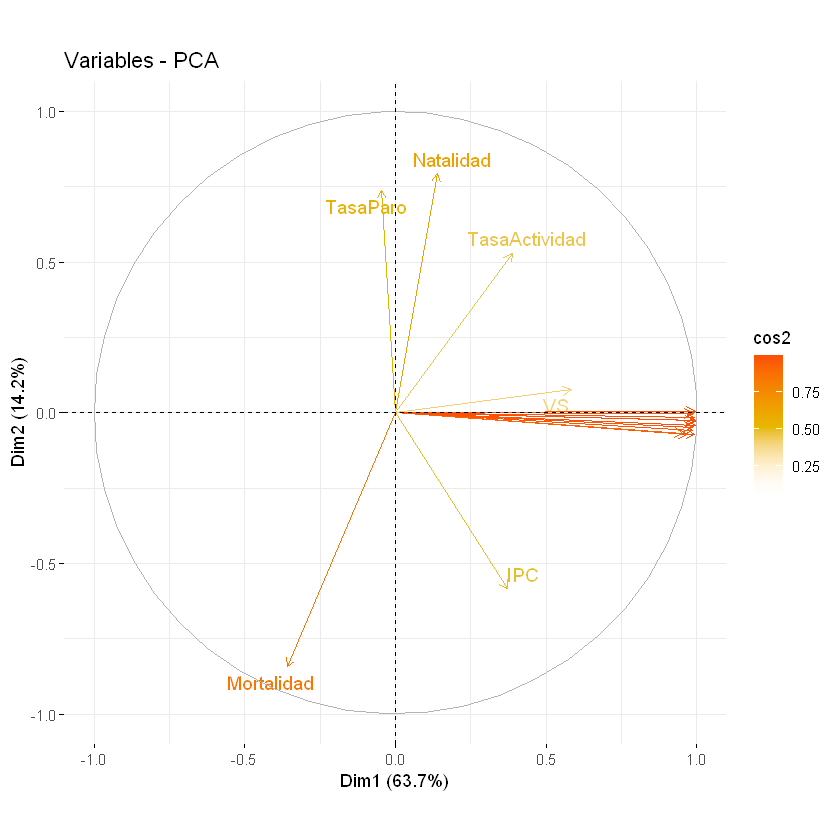

In [51]:
fviz_pca_var(fit,axes = c(1,2), col.var="cos2", gradient.cols = c("00AFBB", "#E7B800","#FC4E07"), repel = TRUE)

Los cosenos al cuadrado son las correlaciones al cuadrado que expresan la proporción de la varianza de cada variable que es explicada por cada componente.

**Con la componente 1**: La variable Mortalidad está relacionada inversamente a la dimensión 1, la tasa de Paro casí no influye en la dimensión 1, parecido es la natalidad. El IPC y a Tasa de actidad influyen de manera similar, y el resto de variables tienen una correlacion muy alta con la componente princiopal 1( de 1 o cercana a 1)

**Con la componente 2**: Destaca la variable Moratlidad que está relacionada inversamente a la dimensión 1 y de forma my relevante, al contrario en positivo está la variable Natalidad y le siguen la Tsa de Paro y TasaActividad.El resto de variables no tienen gran relación con la componente 2.


Warning message:
"ggrepel: 6 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


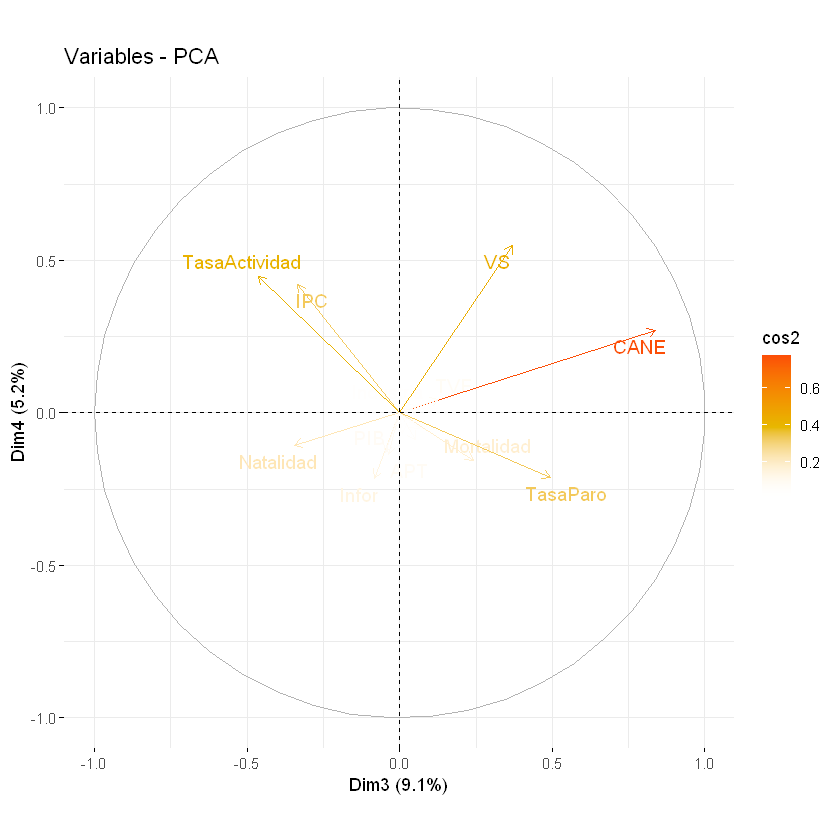

In [52]:
fviz_pca_var(fit,axes = c(3,4), col.var="cos2", gradient.cols = c("00AFBB", "#E7B800","#FC4E07"), repel = TRUE)

**Con la componente 3**: La variable CANE está relacionada directamente a la dimensión 3 de forma relevante, la tasa de Paro y le sigue VS igualmente, pero de forma menor. Inversamente la TasaActividad, Natalidad e IOc.El  resto de variables tienen una correlacion muy baja con la componente princiopal 3.

**Con la componente 4**:Destacan, aunque no tanto como en otras compoennetes,VS y TasaActividad e IPC en la relación directa con la compoennte 4, si bien la tasaParo y Natalidad se relacionan inversamente en valores más bajos. El resto de variables no opresentan demasiada correación con la compoennte 4.

### d. Mostrar la tabla y los gráficos que nos muestran la proporción de la varianza de cada variable que es explicado por cada componente. ¿Cuál de las variables es la que está peor explicada?

In [53]:
knitr::kable(var$cos2, digits =2, caption = "Cosenos al cuadrado")



Table: Cosenos al cuadrado

|              | Dim.1| Dim.2| Dim.3| Dim.4|
|:-------------|-----:|-----:|-----:|-----:|
|Poblacion     |  0.99|  0.00|  0.00|  0.00|
|Mortalidad    |  0.13|  0.71|  0.06|  0.02|
|Natalidad     |  0.02|  0.63|  0.12|  0.01|
|IPC           |  0.14|  0.34|  0.11|  0.18|
|NumEmpresas   |  0.99|  0.00|  0.00|  0.00|
|Industria     |  0.94|  0.01|  0.00|  0.00|
|Construccion  |  0.99|  0.01|  0.00|  0.00|
|CTH           |  0.98|  0.00|  0.00|  0.00|
|Infor         |  0.91|  0.00|  0.01|  0.05|
|AFS           |  0.98|  0.00|  0.00|  0.01|
|APT           |  0.97|  0.00|  0.00|  0.02|
|TasaActividad |  0.15|  0.28|  0.22|  0.20|
|TasaParo      |  0.00|  0.55|  0.25|  0.05|
|Ocupados      |  0.99|  0.00|  0.00|  0.00|
|PIB           |  0.97|  0.00|  0.00|  0.02|
|CANE          |  0.00|  0.02|  0.70|  0.07|
|TVF           |  0.97|  0.00|  0.02|  0.00|
|VS            |  0.34|  0.01|  0.14|  0.30|

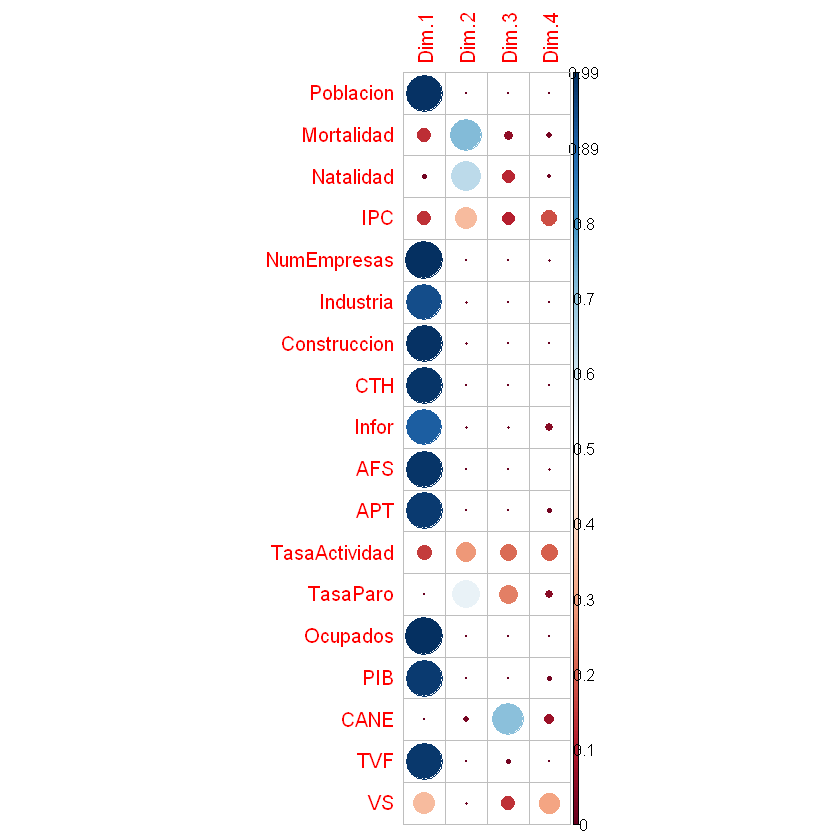

In [54]:
#representación gráfca de los cosenos
corrplot(var$cos2,is.corr=FALSE)

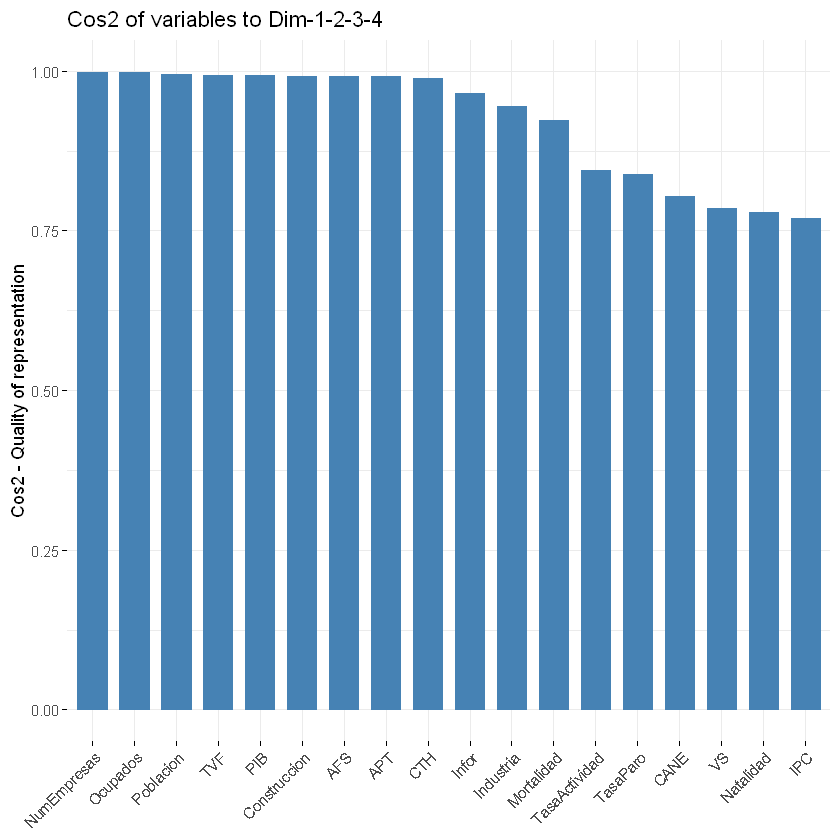

In [55]:
#Porcentaje de variablidad explicada por las cuatro CP
fviz_cos2(fit, choice ="var", axes=1:4)

Tal y como se puede observar, IPC con 0.77 ente las cuatro componentes, es la menor propoción de varianza de una variabel explicada por las compoentes . Por tanto es la peor explicada, en el conjunto de todas ellas.

### e. Mostrar la tabla y los gráficos que nos muestran el porcentaje de la varianza de cada Componente que es debido a cada variable. ¿Que variables contribuyen más a cada Componente?

In [22]:
knitr::kable(var$contrib, digits =2,caption ="Contribuciones")



Table: Contribuciones

|              | Dim.1| Dim.2| Dim.3| Dim.4|
|:-------------|-----:|-----:|-----:|-----:|
|Poblacion     |  8.62|  0.00|  0.25|  0.29|
|Mortalidad    |  1.13| 27.79|  3.57|  2.60|
|Natalidad     |  0.17| 24.54|  7.33|  1.20|
|IPC           |  1.21| 13.35|  6.88| 18.93|
|NumEmpresas   |  8.65|  0.07|  0.01|  0.48|
|Industria     |  8.16|  0.20|  0.22|  0.05|
|Construccion  |  8.60|  0.21|  0.01|  0.07|
|CTH           |  8.58|  0.01|  0.24|  0.08|
|Infor         |  7.92|  0.18|  0.42|  4.91|
|AFS           |  8.55|  0.03|  0.16|  0.84|
|APT           |  8.45|  0.09|  0.08|  2.01|
|TasaActividad |  1.31| 10.93| 13.16| 21.44|
|TasaParo      |  0.02| 21.30| 15.00|  4.85|
|Ocupados      |  8.67|  0.03|  0.00|  0.36|
|PIB           |  8.46|  0.13|  0.14|  1.79|
|CANE          |  0.03|  0.93| 43.13|  7.75|
|TVF           |  8.50|  0.00|  1.00|  0.19|
|VS            |  2.97|  0.23|  8.42| 32.16|

La contribución de una variable a una componente es el porcentaje de la varianza de la Componente que proviene de esa variable

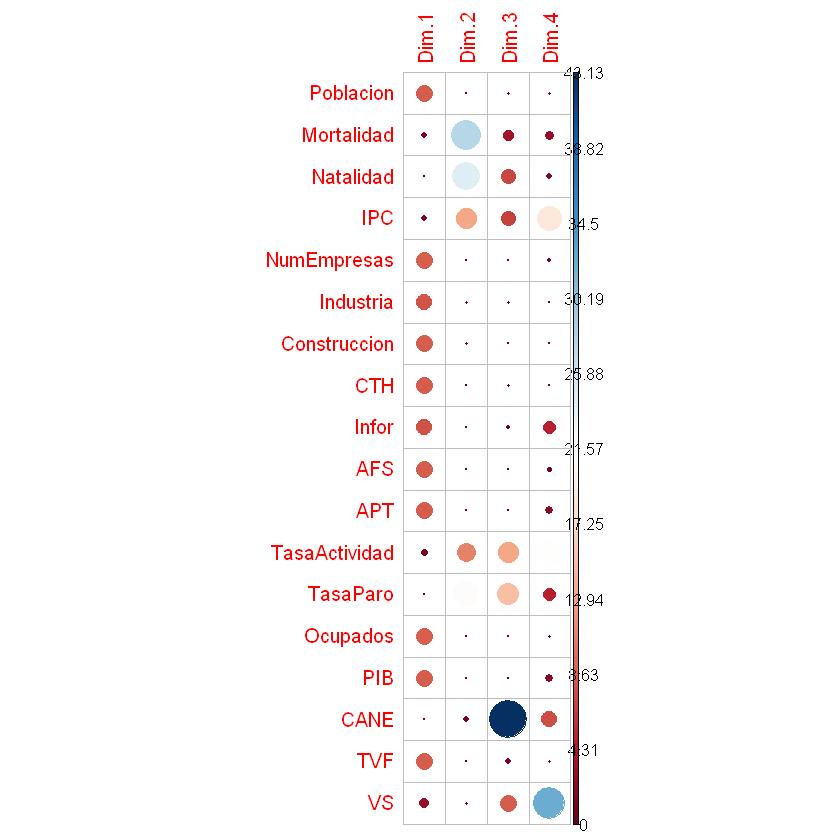

In [23]:
corrplot(var$contrib, is.corr= FALSE)

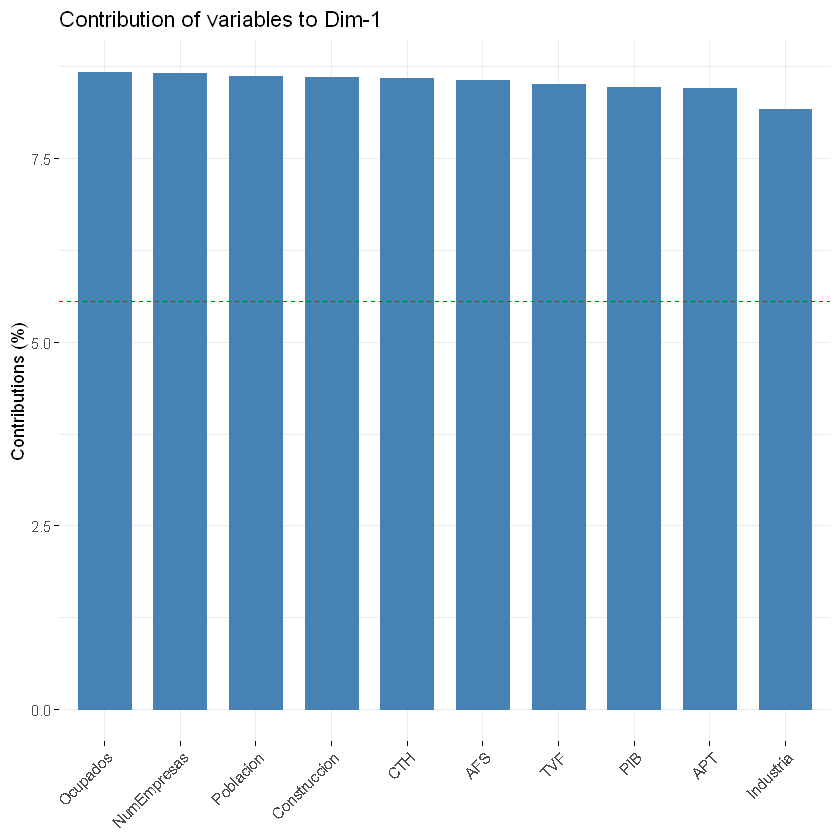

In [24]:
#Contribución de las vairbales a la componente 1
fviz_contrib(fit,choice="var", axes=1, top=10)

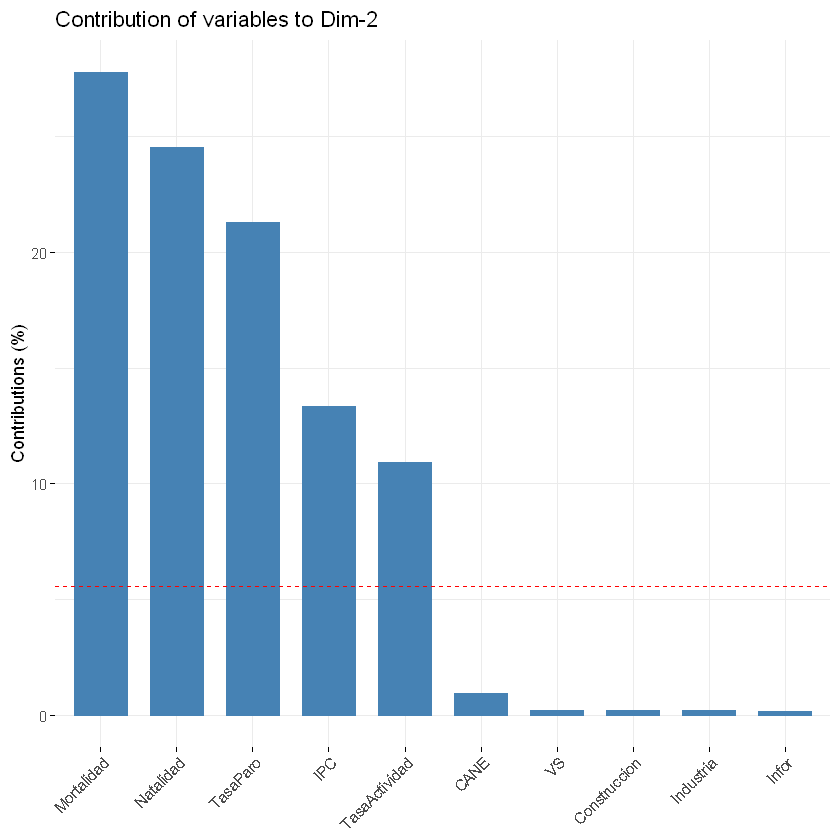

In [25]:
#Contribución de las vairbales a la componente 2
fviz_contrib(fit,choice="var", axes=2, top=10)

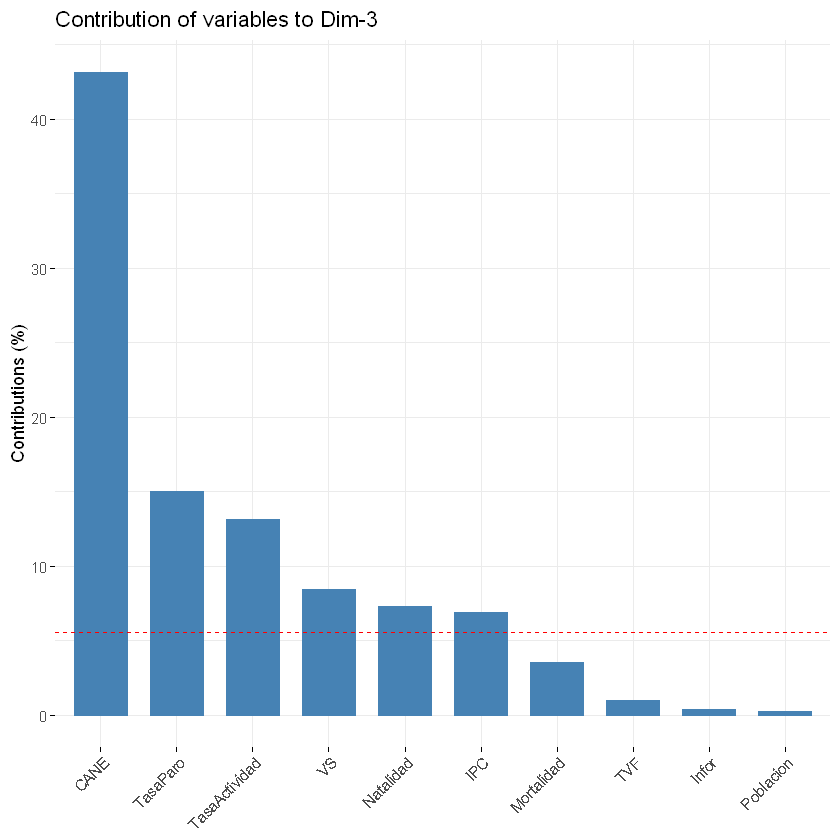

In [26]:
#Contribución de las vairbales a la componente 3
fviz_contrib(fit,choice="var", axes=3, top=10)

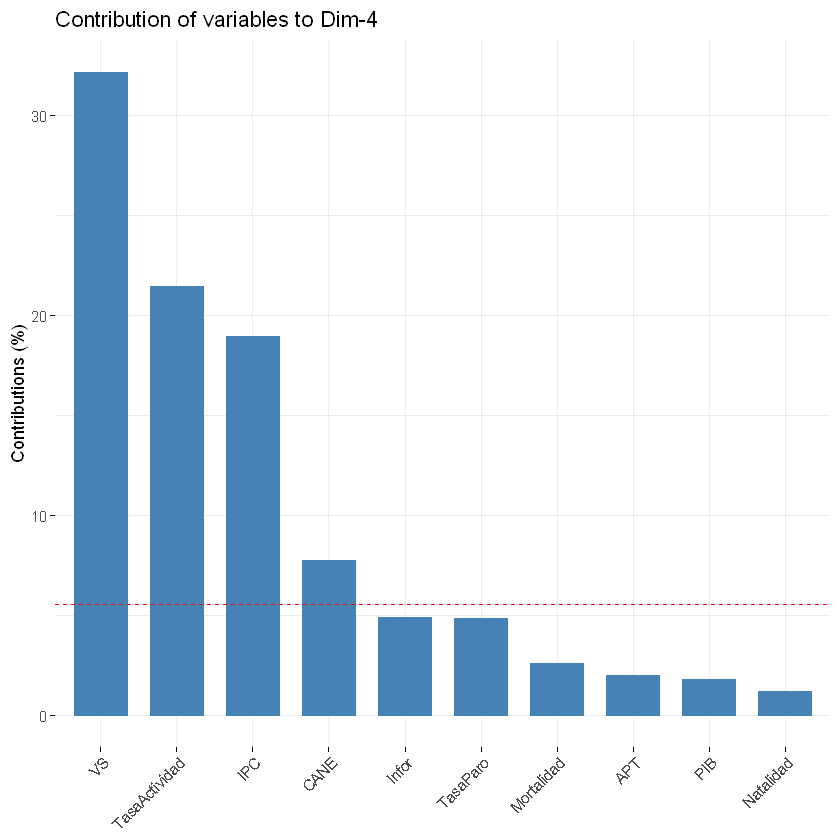

In [27]:
#Contribución de las vairbales a la componente 4
fviz_contrib(fit,choice="var", axes=4, top=10)

Tal y como aparece reflejado en el gráfico y en la tabla de contribuciones, las variables que más contribuyen a cada componente son:

**componente 1:** Poblacion, NumEmpresas, Ocupados,Construccion,CTH,AFS,APT,PIB,TVF

**componente 2:** Mortalidad, natalidad, IPC, TasaActividad,TasaParo

**componente 3:** CANE, TasaActividad,TasaParo

**componente 4:** IPC, TasaActividad,VS

### f. Sobre los gráficos que representan las observaciones en los nuevos ejes y el gráfico Biplot., teniendo en cuenta la posición de las provincias en el gráfico Comentar las provincias que tienen una posición más destacada en cada componente, en positivo o negativo, ¿Qué significa esto en términos socioeconómicos para estas provincias?

¿Qué valores toman las variables en las nuevas componentes?

In [56]:
ind<-get_pca_ind(fit)
knitr::kable(ind$coord, digits =3, caption = " valores de las provincias en las componentes principales")



Table:  valores de las provincias en las componentes principales

|            |  Dim.1|  Dim.2|  Dim.3|  Dim.4|
|:-----------|------:|------:|------:|------:|
|Albacete    | -1.410|  0.473|  0.096| -0.458|
|Alicante    |  3.384|  0.540|  1.919|  2.420|
|Almería     | -0.617|  2.614|  0.208| -0.142|
|Álava       | -1.444| -0.001| -2.032| -0.113|
|Asturias    | -0.204| -1.953|  1.298| -0.714|
|Badajoz     | -1.048|  1.168|  1.796| -0.854|
|Balears     |  1.526|  0.260| -2.519|  2.364|
|Barcelona   | 13.683| -1.612| -0.867| -0.279|
|Bizkaia     |  0.576| -1.508| -1.180| -0.383|
|Burgos      | -1.202| -1.550| -0.892|  0.989|
|Cantabria   | -0.849| -1.126| -0.594|  0.401|
|Castellón   | -0.690|  0.821|  0.518|  0.382|
|Ceuta       | -2.125|  3.326| -1.811| -1.165|
|Ciudad Real | -1.392|  0.815|  1.819| -0.774|
|Coruña      |  0.635| -1.442|  0.759|  0.244|
|Cuenca      | -2.132| -0.569|  1.048| -0.932|
|Cáceres     | -1.503| -0.180|  1.269| -0.223|
|Cádiz       |  0.128|  1.771|  0.369| 

Warning message:
"ggrepel: 5 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


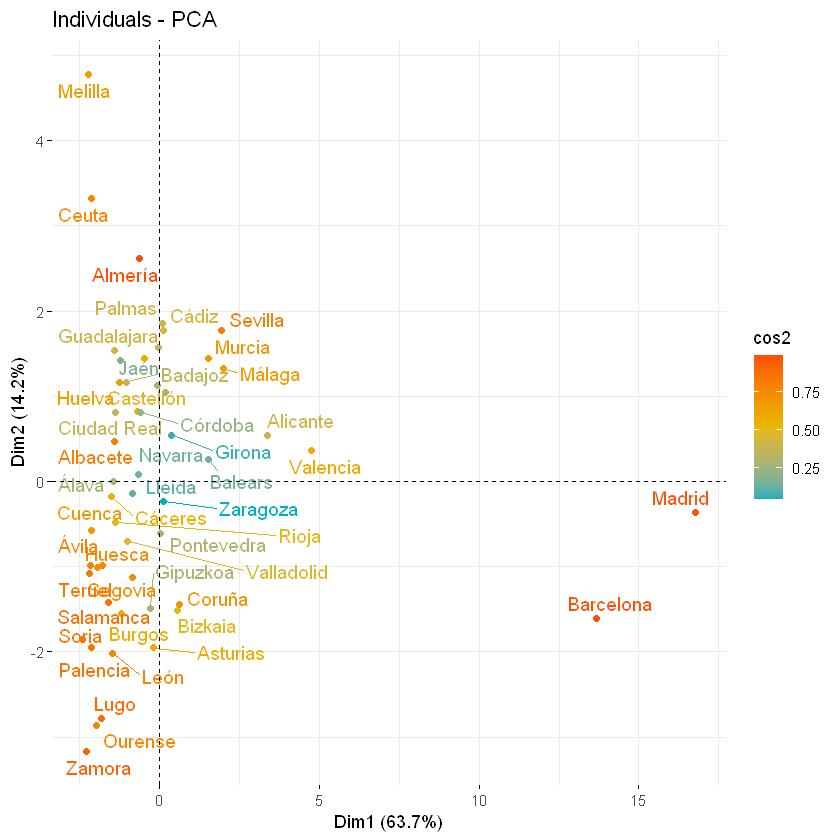

In [57]:
fviz_pca_ind(fit, col.ind = "cos2", gradient.cols = c("#00AFBB", "#E7B800", "#FC4E07"), repel = TRUE)

Warning message:
"ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


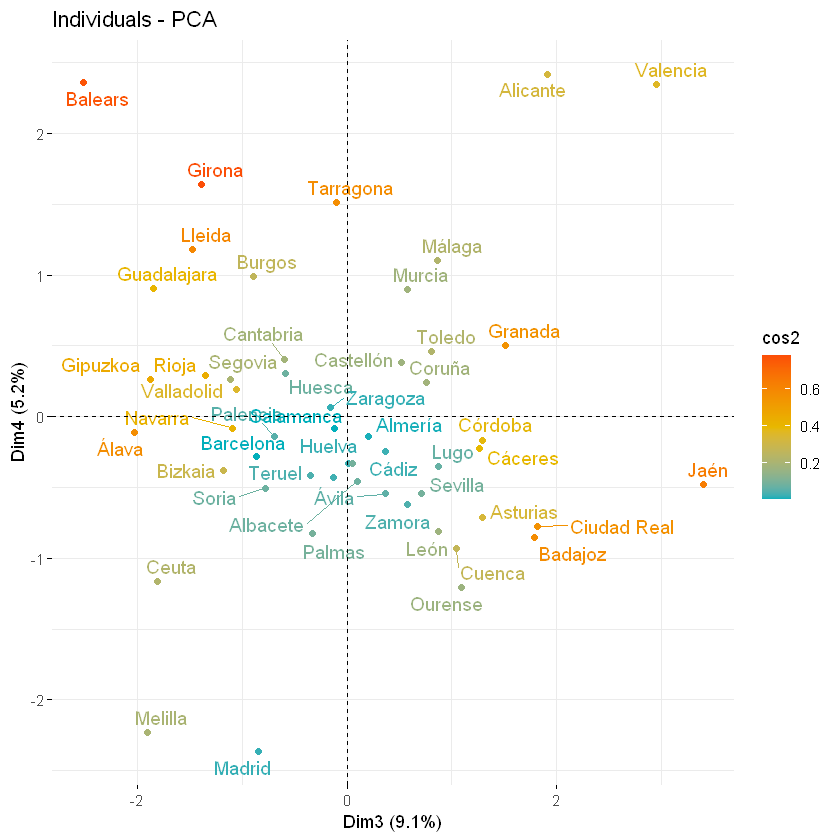

In [58]:
fviz_pca_ind(fit,axes = c(3,4), col.ind = "cos2", gradient.cols = c("#00AFBB", "#E7B800", "#FC4E07"), repel = TRUE)


Warning message:
"ggrepel: 9 unlabeled data points (too many overlaps). Consider increasing max.overlaps"
Warning message:
"ggrepel: 11 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


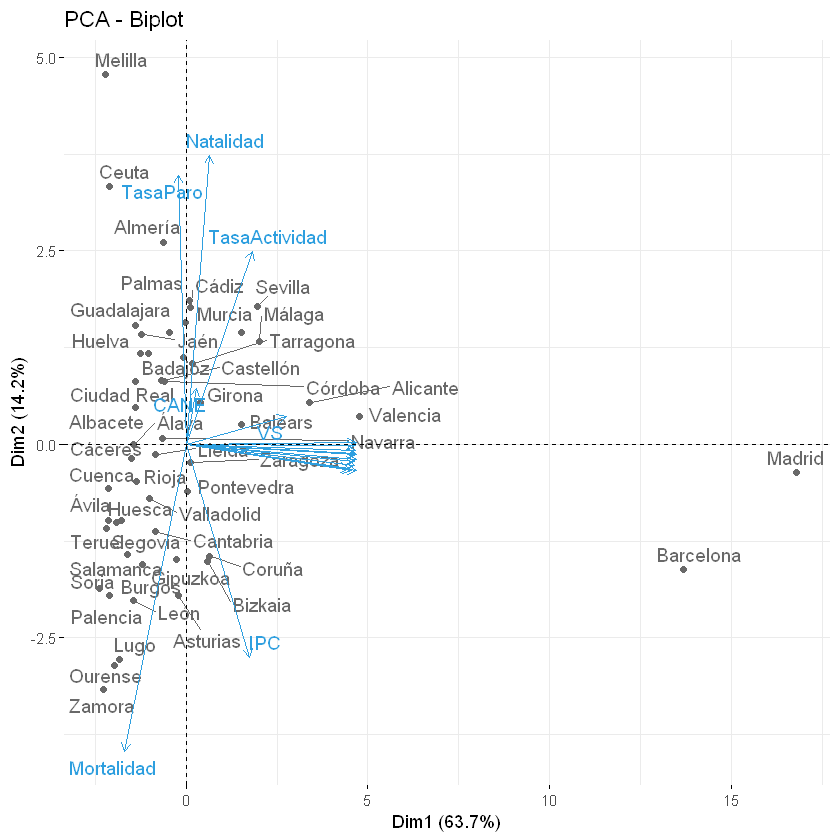

In [59]:
#representación conjunta de los individuos  las variables en los planos de las CP
fviz_pca_biplot(fit, repel = TRUE, col.var="#2E9FDF", col.ind = "#696969")

Warning message:
"ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


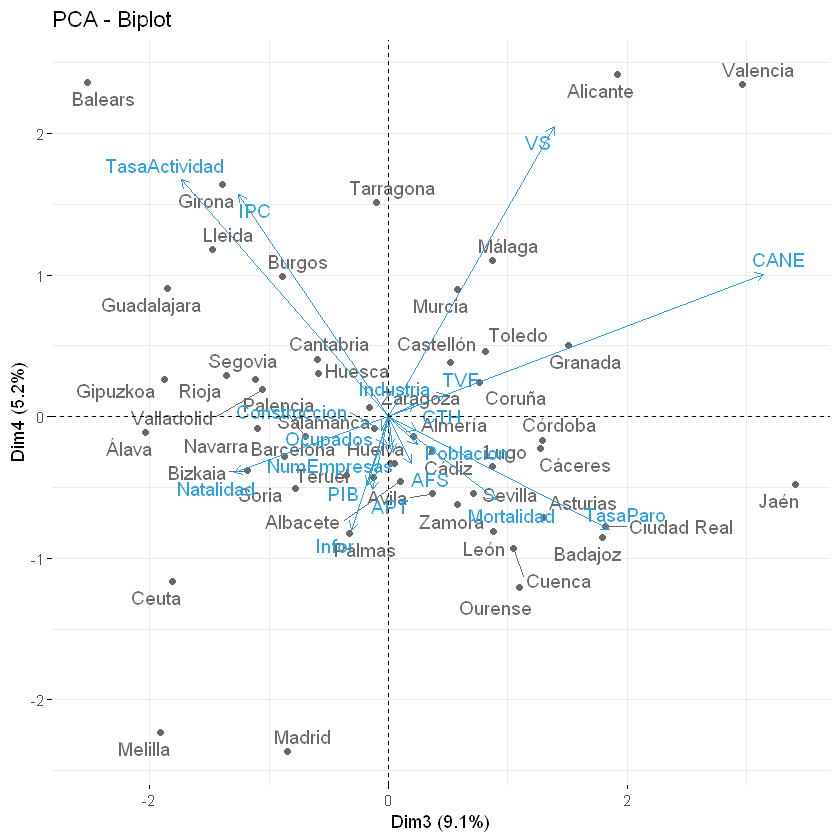

In [60]:
fviz_pca_biplot(fit,axes = c(3,4), repel = TRUE, col.var="#2E9FDF", col.ind = "#696969")

Tal y como aparece reflejado en los gráficos y en la tabla de valores de las provincias en las componentes principales,
las provincias que más se relacionan con cada compnente representan:

**componente 1:** Destacan claramente Madrid y Barcelona como las provincias con los mayores valores en relación  la Poblacion, NumEmpresas, Ocupados,Construccion,CTH,AFS,APT,PIB,TVF

**componente 2:** Destacan Melilla ceuta y Almería como pronicias con mayor tasa de paro, mayor natalidad. Mortalidad, natalidad, IPC, TasaActividad,TasaParo

**componente 3:** Destacan las provincias de Ciudad Real, Badajoz, Asturias, en Tasa de Paro, Jaen en relacón al CANE, CANE, y al contrario Girona, Lleida , Burgos y Balares con una mayor tasa de Actividad
**componente 4:** Destacan Baleares y Girona por su tasa de Actividad y Madr44

### 3. Si tuviéramos que construir un índice que valore de forma conjunta el desarrollo económico de una provincia, como se podría construir utilizando una combinación lineal de todas las variables. ¿Cuál sería el valor de dicho índice en Madrid? ¿Cual sería su valor en Melilla?

La componente principal nº 1 resumiría esa valoración conjunta del desarrollo de una provincia.
El valor que adoptaría Madrid en esa componente principal sería:  16.778|
El valor que adoptaría Melilla en esa componente principal sería:  -2.218

Lógicamente se puede apreciar la diferencia entre las dos provincias.|

### 4. Representar un mapa de calor de la matriz de datos, estandarizado y sin estandarizar para ver si se detectan inicialmente grupos de provincias.

In [61]:

#Exploración  inicial de datos, primera aporximación sin extandarizar variables
heatmaply(dat_provincias,seriate="mean",row_dend_left=TRUE,plot_method="plotly")


HTML widgets cannot be represented in plain text (need html)

In [62]:
#estandarizamos los datos:
dat_provincias_st<- scale(dat_provincias)

#Exploración  inicial de datos, primera aproximación extandarizando variables
heatmaply(dat_provincias_st,seriate="mean",row_dend_left=TRUE,plot_method="plotly")


HTML widgets cannot be represented in plain text (need html)

No se perciben bien los grupos de provincias, tal vez se puede apreciar que en el segundo mapa de calor correspodiente a las variables estandarizadas, Madrid y Barcelona parecen separadas del resto en gran parte de las variables.

Procedemos a calcular la matriz de distancias con las variables sin estandarizary estandarizadas para analiar si se pueden observar ya grupos de provincias.

In [63]:
#Calculamos las distncias con los valores sin estandarizar
d<- dist(dat_provincias, method="euclidean")#sobre fichero datos numérico
d6<-as.matrix(d)[1:6,1:6]#lo transforma en matriz
knitr::kable(d6, digits =2, caption = "Distancias")#funciona solo sobre matrices



Table: Distancias

|         | Albacete| Alicante|  Almería|      Álava| Asturias|    Badajoz|
|:--------|--------:|--------:|--------:|----------:|--------:|----------:|
|Albacete |        0| 24971242|  4687257|  3481471.5| 14555211|  3362039.7|
|Alicante | 24971242|        0| 20284171| 21510859.3| 10424490| 21610942.1|
|Almería  |  4687257| 20284171|        0|  1277176.4|  9869791|  1328833.4|
|Álava    |  3481472| 21510859|  1277176|        0.0| 11088936|   452219.3|
|Asturias | 14555211| 10424490|  9869791| 11088935.7|        0| 11197887.0|
|Badajoz  |  3362040| 21610942|  1328833|   452219.3| 11197887|        0.0|

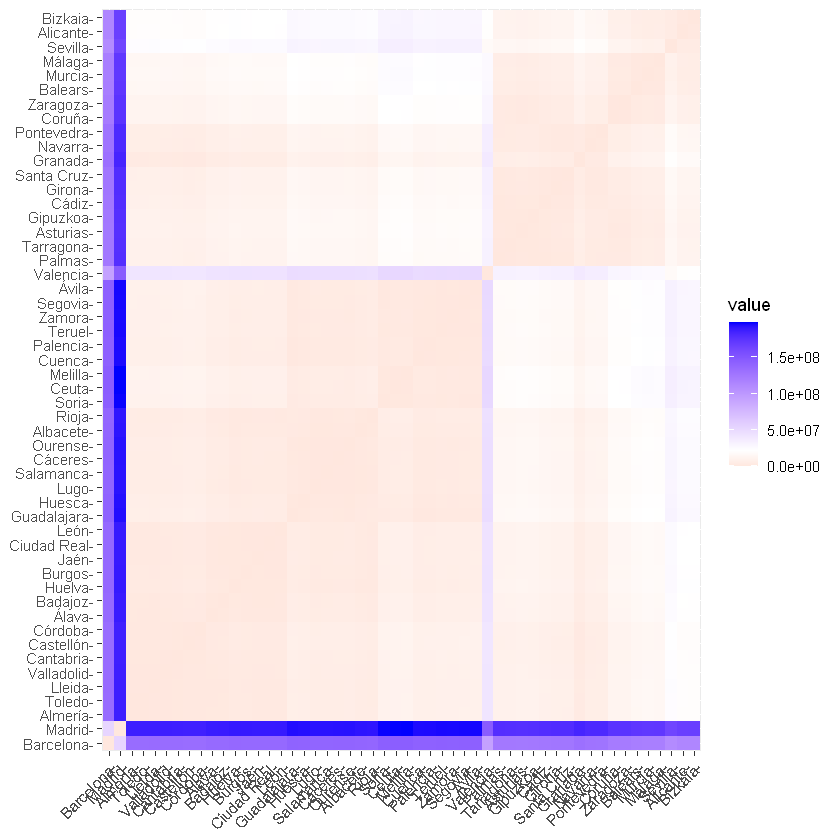

In [64]:
#distancia ente las variables, representación de calor de tabla distancias
fviz_dist(d, show_labels = TRUE)# de factor extra

Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."
Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."
Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."
Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."


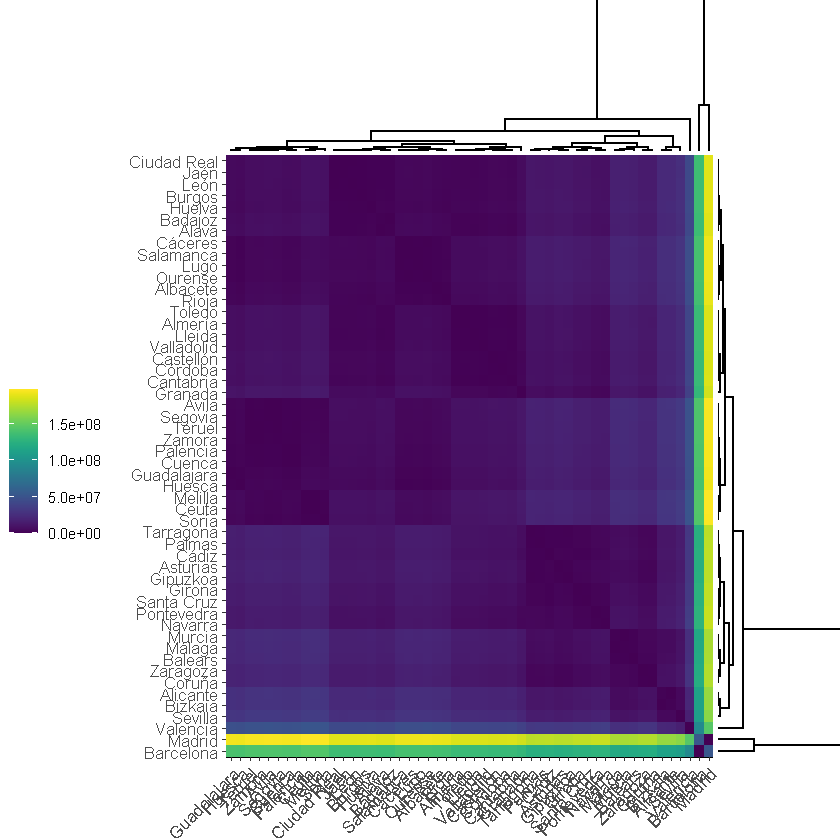

In [65]:
ggheatmap(as.matrix(d), seriate="mean")#actua sobre una matriz,
#no necesariamente la de distancias, por eso guadamos d como matriz

In [66]:
heatmaply(as.matrix(d),seriate="OLO",row_dend_left=TRUE,plot_method="plotly")
#este algoritmo olo no consigue realmente mejorar la representación

HTML widgets cannot be represented in plain text (need html)

In [67]:
#estandarizamos los datos:
dat_provincias_st<-scale(dat_provincias)

#Calculamos las distncias con los valores sin estandarizar
d_st<- dist(dat_provincias_st, method="euclidean")#sobre fichero datos numérico
d6_st<-as.matrix(d_st)[1:6,1:6]#lo transforma en matriz
knitr::kable(d6_st, digits =2, caption = "Distancias")#funciona solo sobre matrices



Table: Distancias

|         | Albacete| Alicante| Almería| Álava| Asturias| Badajoz|
|:--------|--------:|--------:|-------:|-----:|--------:|-------:|
|Albacete |     0.00|     6.60|    2.37|  2.45|     3.11|    1.92|
|Alicante |     6.60|     0.00|    6.07|  7.35|     5.90|    6.35|
|Almería  |     2.37|     6.07|    0.00|  3.68|     4.77|    2.39|
|Álava    |     2.45|     7.35|    3.68|  0.00|     4.20|    4.22|
|Asturias |     3.11|     5.90|    4.77|  4.20|     0.00|    3.37|
|Badajoz  |     1.92|     6.35|    2.39|  4.22|     3.37|    0.00|

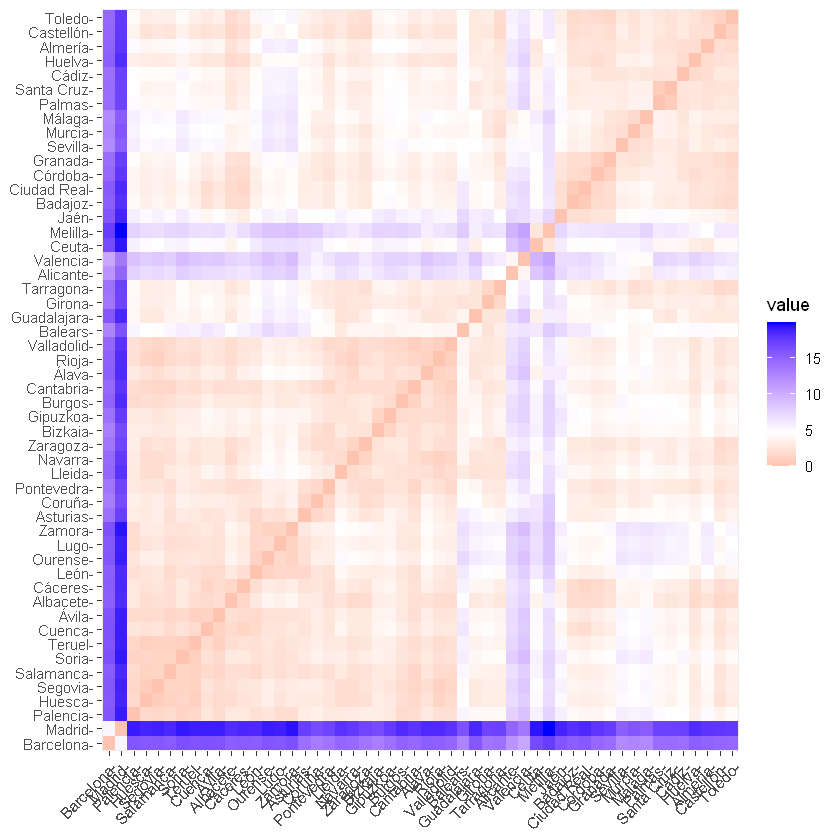

In [68]:
#distancia ente las variables, representación de calor de tabla distancias
fviz_dist(d_st, show_labels = TRUE)# de factor extra

No se aprecia muy bien, pero más o menos se puede sacar en consecuencia que valencia y Alicante presentan enos distancias entre ellos y más con el resto. Que hay do grandes grupos, dos grandes cuadrados. Ceuta y melilla también presentan una diferenciación con el resto que habrá que analizar. 

Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."
Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."
Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."
Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."


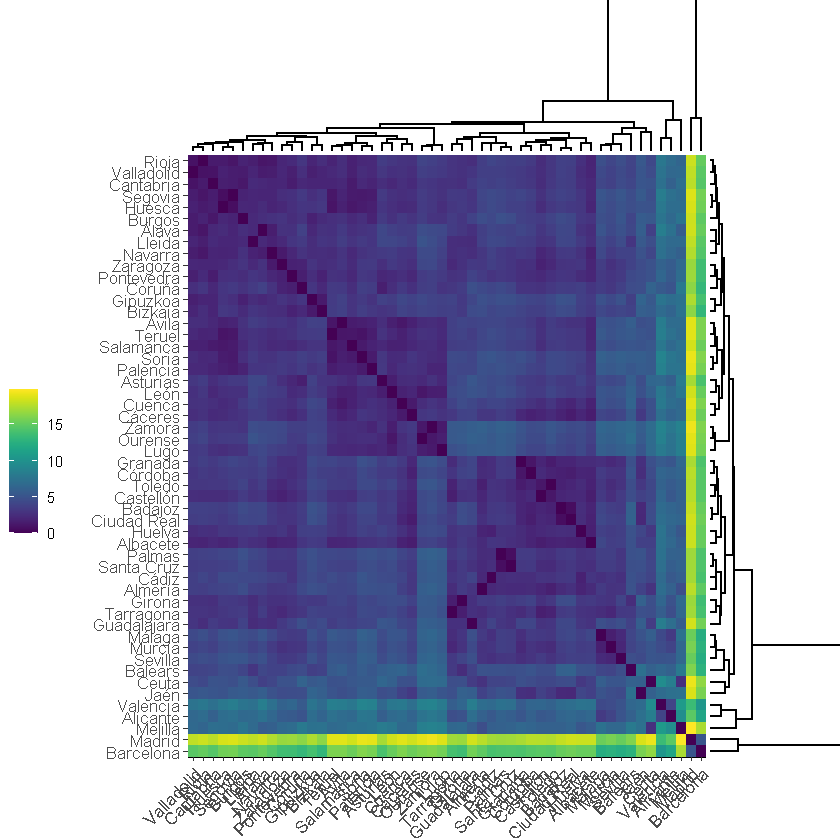

In [69]:
ggheatmap(as.matrix(d_st), seriate="mean")#actua sobre una matriz,
#no necesariamente la de distancias, por eso guadamos d como matriz

In [70]:
heatmaply(as.matrix(d_st),seriate="OLO",row_dend_left=TRUE,plot_method="plotly")
#este algoritmo olo no consigue realmente mejorar la representación

HTML widgets cannot be represented in plain text (need html)

### 5. Realizar un análisis Jerárquico de clusters para determinar si existen grupos de provincias con comportamiento similar.

#### a. A la vista del dendrograma ¿Cuántos clusters recomendarías?

Voy a realizar una agrupación jerárquica con los datos sin estandarizar y otra con los 
datos estandarizados representando ambos dendrogramas. 

In [71]:
#agrupamos las observaciones según el criterio de ward
#mediante la función hclust q actúa sobre la matriz 
#de distancias sin estandarizar 
res.hc<-hclust(d, method="ward.D2")

Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."


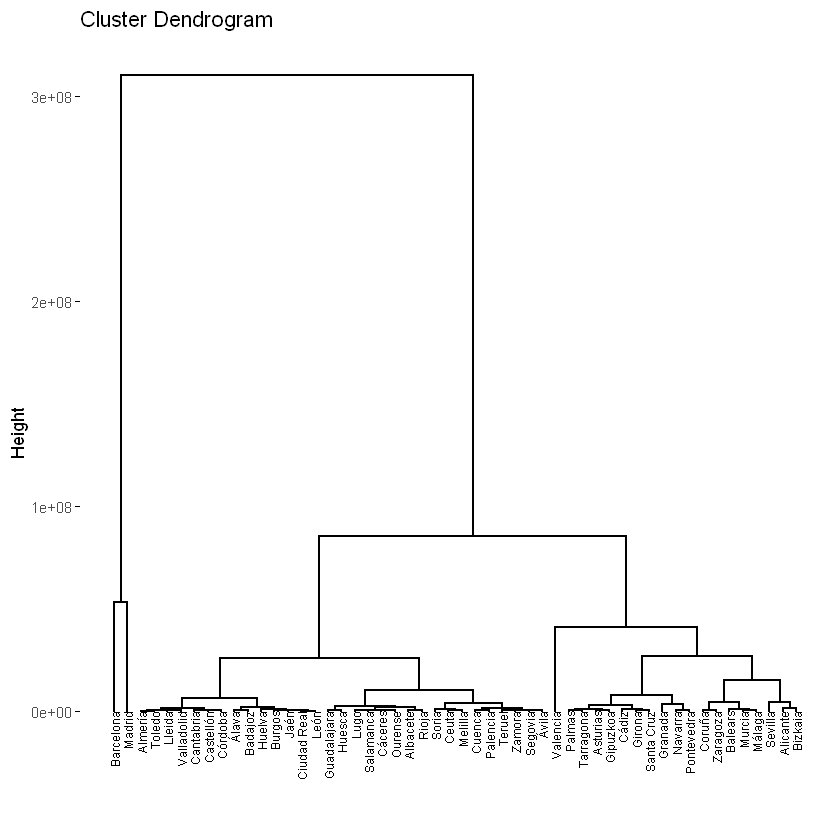

In [72]:
#Dibujamos dendograma correspondiente
fviz_dend(res.hc, cex = 0.5)

Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."


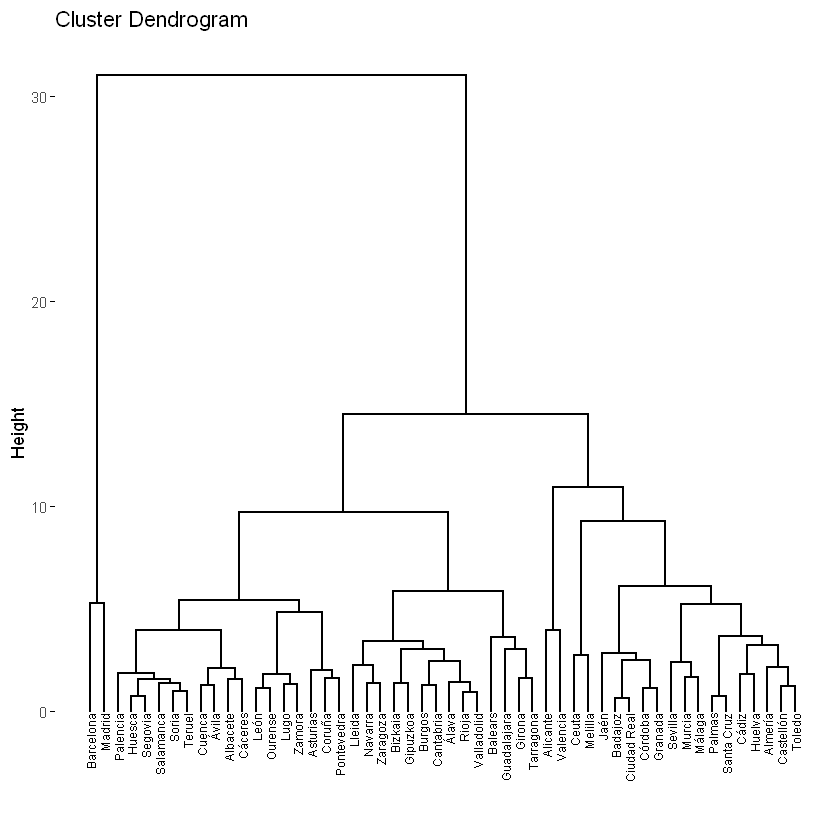

In [73]:
#agrupamos las observaciones según el criterio de ward
#mediante la función hclust q actúa sobre la matriz 
#de distancias sin estandarizar 
res.hc_st<-hclust(d_st, method="ward.D2")
#Dibujamos dendograma correspondiente
fviz_dend(res.hc_st, cex = 0.5)

A la vista del dendograma yo recomendaría incialmente 5 clusters.

#### b. Representar los individuos agrupados según el número de clusters elegido.

In [75]:
#Seleccionamos 5 clusters
grp <- cutree(res.hc_st, k=5)
#número de miembros de cada cluster
knitr::kable(table(grp), caption = "número de individuos por cluster")
cat("cluster 1 = ",rownames(dat_provincias)[grp ==1], "\n")
cat("cluster 2 = ",rownames(dat_provincias)[grp ==2], "\n")
cat("cluster 3 = ",rownames(dat_provincias)[grp ==3], "\n")
cat("cluster 4 = ",rownames(dat_provincias)[grp ==4], "\n")
cat("cluster 5 = ",rownames(dat_provincias)[grp ==5], "\n")




Table: número de individuos por cluster

|grp | Freq|
|:---|----:|
|1   |   17|
|2   |    2|
|3   |   17|
|4   |   14|
|5   |    2|

cluster 1 =  Albacete Asturias Coruña Cuenca Cáceres Huesca León Lugo Ourense Palencia Pontevedra Salamanca Segovia Soria Teruel Zamora Ávila 
cluster 2 =  Alicante Valencia 
cluster 3 =  Almería Badajoz Castellón Ceuta Ciudad Real Cádiz Córdoba Granada Huelva Jaén Melilla Murcia Málaga Palmas Santa Cruz Sevilla Toledo 
cluster 4 =  Álava Balears Bizkaia Burgos Cantabria Gipuzkoa Girona Guadalajara Lleida Navarra Rioja Tarragona Valladolid Zaragoza 
cluster 5 =  Barcelona Madrid 


Con los datos de variabels estandarizadas se acusan mucho más las diferencias entre clusters y es más fácil dferenciarlos en el dendograma.

#### c. ¿Qué número óptimo de clusters nos indican los criterios Silhoutte y de Elbow?

Warning message in get_col(col, k):
"Length of color vector was longer than the number of clusters - first k elements are used"
Warning message:
"`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead."


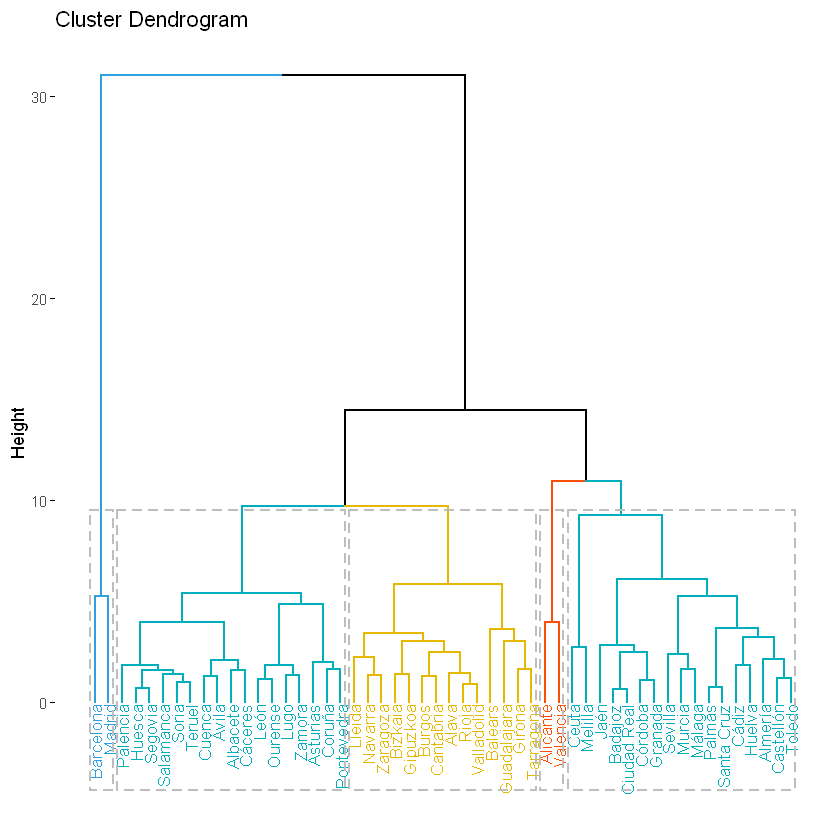

In [76]:
#esta función representa el dendograma con el número de cluster decidido
fviz_dend(res.hc_st, k=5, 
         cex = 0.7,#tamaño
         k_colors = c("#2E9FDF", "#00AFBB", "#E7B800", "#FC4E07","#00AFBB","#2E9FDF"),
         COLOR_LABLES_BY_K = true, #Diferentes colores a los clusters
         rect = TRUE)#añade un rectangulo alrededor

Podemos apreciar 5 clústers que se comprueban.

In [96]:
#Podemos realizar los pasos anteriores a las representaciones con la función agnes que directaente estandariza, calcula las distancias entre individuos y realiza el cluster jerarqueico. De factominR
#Agglomerative Nesting (Hierachical Clustering)
#res.agnes<-agnes(x=dat_provincias,#datos originales, no las distancias
                ##stand = TRUE, #standarizamos
               # metric = "euclidean",#distancia entre individuos
                #method = "ward") #distncia entre clusters

#representamos la función
#fviz_dend(res.agnes, cex = 0.6, k=5)

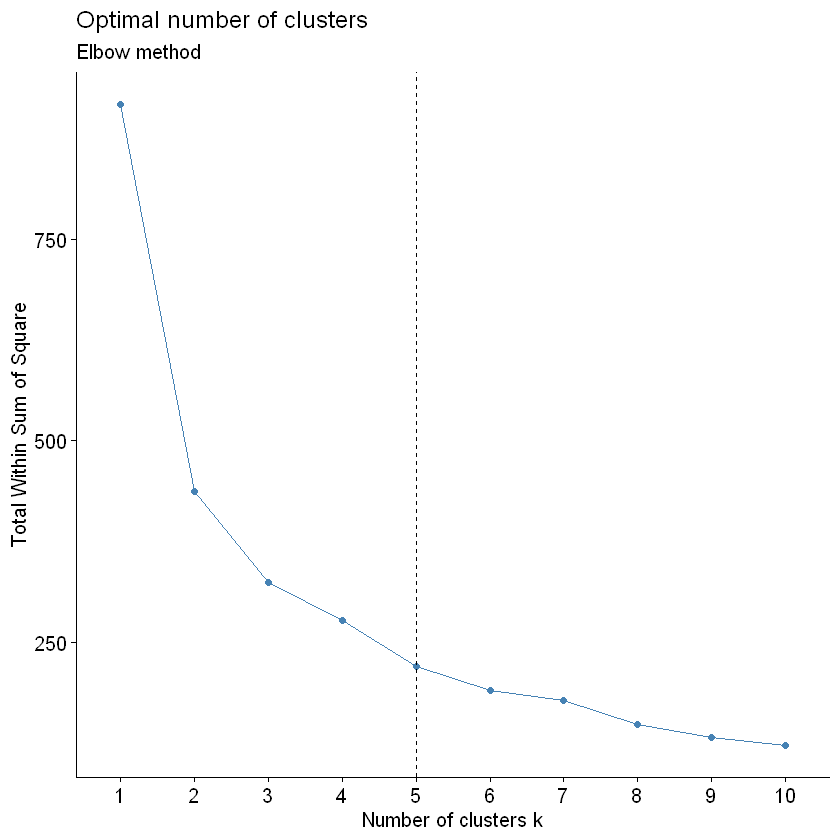

In [78]:
#Determinación del número óptimo de clusters
#Elbow method
fviz_nbclust(dat_provincias_st, kmeans, method = "wss")+
    geom_vline(xintercept = 5, linetype = 2)+
    labs(subtitle ="Elbow method")

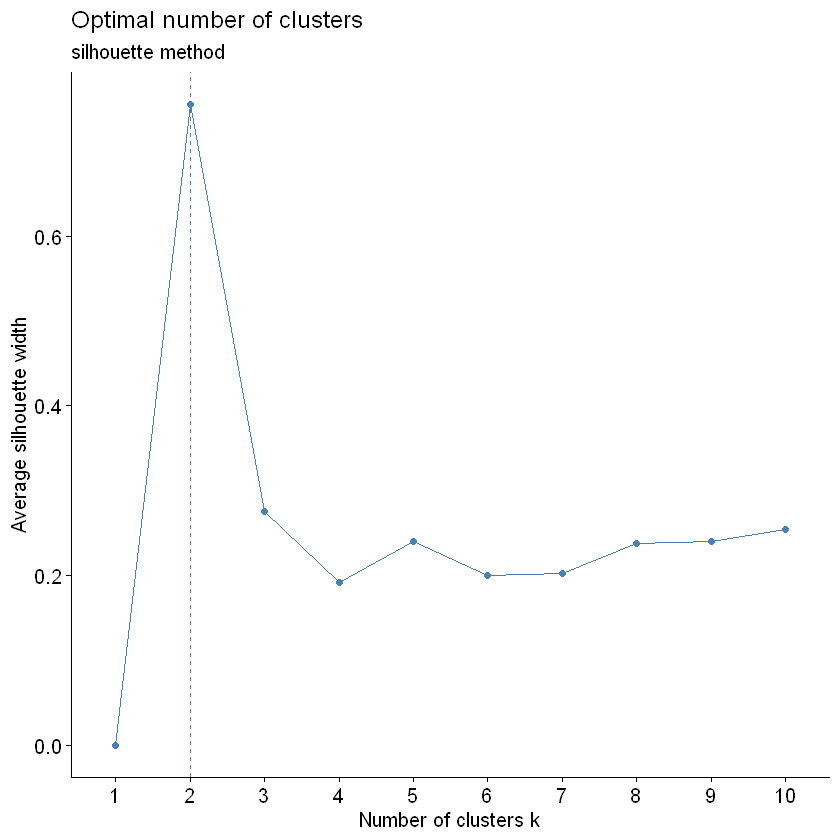

In [79]:
#otro criterio, analiza la compactación de los clusters
#Silhouette
fviz_nbclust(dat_provincias_st, kmeans, method = "silhouette")+
    labs(subtitle ="silhouette method")

Nos indican 5 clústers, identificando en Silhoutte un máximo y en Elbow se identifica como el valor a partir del cual ya no hay cambiaos de tendencia apreciables.

#### d. Con el número de clusters decidido en el apartado anterior realizar un agrupamiento no jerárquico

##### i. Representar los clusters formados en los planos de las Componentes principales. Relacionar la posición de cada cluster en el plano con lo que representa cada componente principal.


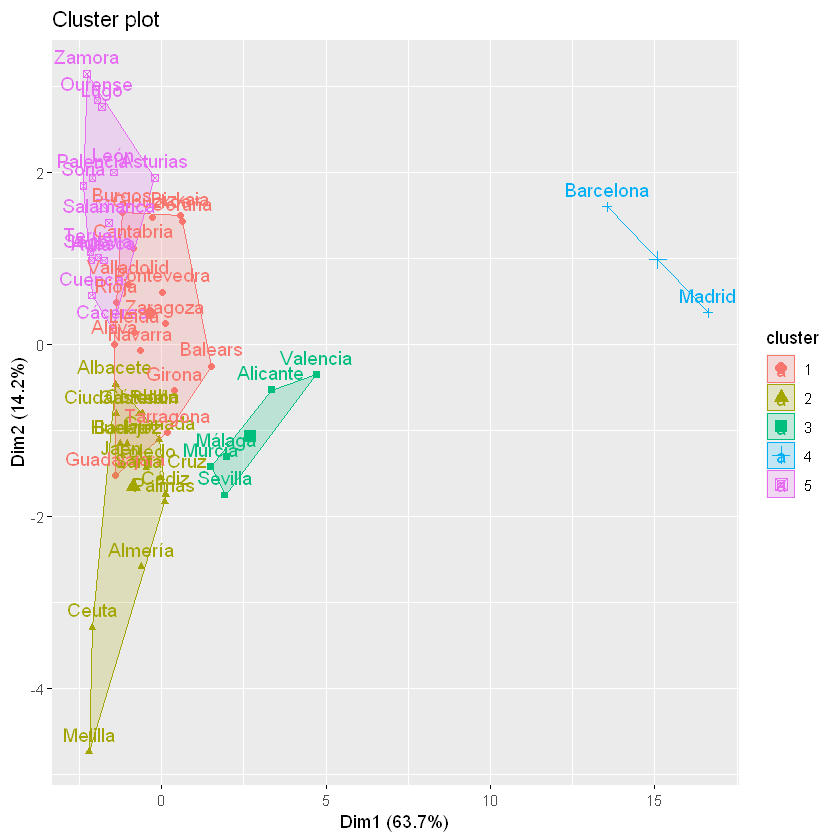

In [81]:
# Probamos con 5 Clusters 
RNGkind(sample.kind = "Rejection")
set.seed(1234)
km.res5 <- kmeans(dat_provincias_st, 5)
fviz_cluster(km.res5,  dat_provincias_st)

##### ii. Evaluar la calidad de los clusters
 

In [178]:
#Evaluación de la calidad de los clusters 
sil <- silhouette(km.res5$cluster, dist(dat_provincias_st))
rownames(sil) <- rownames(df_datos)

sil[,1:3]

,cluster,neighbor,sil_width
Albacete,2,5,-0.02095427
Alicante,3,1,0.33921400
Almería,2,1,0.31029613
Álava,1,5,0.22812174
Asturias,5,1,0.26330217
Badajoz,2,5,0.26174926


,cluster,neighbor,sil_width
Albacete,2,5,-0.02095427
Alicante,3,1,0.33921400
Almería,2,1,0.31029613
Álava,1,5,0.22812174
Asturias,5,1,0.26330217
Badajoz,2,5,0.26174926
Balears,1,3,0.25027123
Barcelona,4,3,0.55872598
Bizkaia,1,5,0.21354124
Burgos,1,5,0.03868150


Como se aprecia en el gráfico, aunque efectivamente existe algun parámetro que no se consigue 100 % que quede diferenciado, el crietrio de los 5 clústers es apropiado.

  cluster size ave.sil.width
1       1   16          0.17
2       2   15          0.17
3       3    5          0.23
4       4    2          0.60
5       5   14          0.34


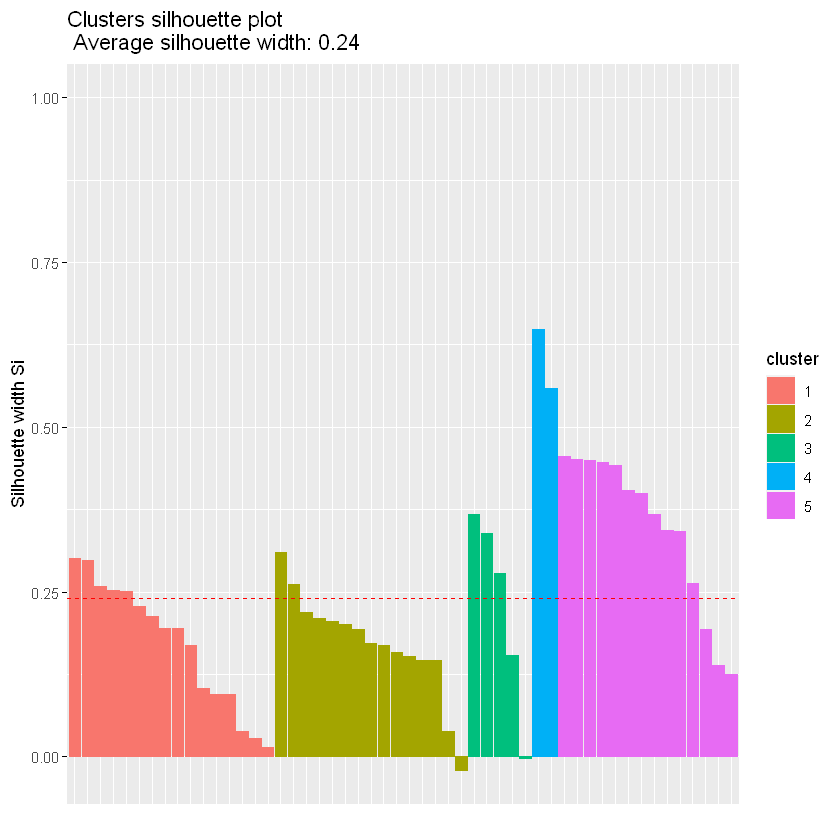

In [184]:
fviz_silhouette(sil)

In [181]:
ordenado<-sort(km.res5$cluster)
knitr::kable(ordenado, digits =2, caption = "Provincia y Cluster")



Table: Pais y Cluster

|            |  x|
|:-----------|--:|
|Álava       |  1|
|Balears     |  1|
|Bizkaia     |  1|
|Burgos      |  1|
|Cantabria   |  1|
|Coruña      |  1|
|Gipuzkoa    |  1|
|Girona      |  1|
|Guadalajara |  1|
|Lleida      |  1|
|Navarra     |  1|
|Pontevedra  |  1|
|Rioja       |  1|
|Tarragona   |  1|
|Valladolid  |  1|
|Zaragoza    |  1|
|Albacete    |  2|
|Almería     |  2|
|Badajoz     |  2|
|Castellón   |  2|
|Ceuta       |  2|
|Ciudad Real |  2|
|Cádiz       |  2|
|Córdoba     |  2|
|Granada     |  2|
|Huelva      |  2|
|Jaén        |  2|
|Melilla     |  2|
|Palmas      |  2|
|Santa Cruz  |  2|
|Toledo      |  2|
|Alicante    |  3|
|Murcia      |  3|
|Málaga      |  3|
|Sevilla     |  3|
|Valencia    |  3|
|Barcelona   |  4|
|Madrid      |  4|
|Asturias    |  5|
|Cuenca      |  5|
|Cáceres     |  5|
|Huesca      |  5|
|León        |  5|
|Lugo        |  5|
|Ourense     |  5|
|Palencia    |  5|
|Salamanca   |  5|
|Segovia     |  5|
|Soria       |  5|
|Terue

In [185]:
knitr::kable(km.res5$centers, digits =2,caption = "Estadísticos de los clusters, datos STD") 



Table: Estadísticos de los clusters, datos STD

| Poblacion| Mortalidad| Natalidad|   IPC| NumEmpresas| Industria| Construccion|   CTH| Infor|   AFS|   APT| TasaActividad| TasaParo| Ocupados|   PIB|  CANE|   TVF|    VS|
|---------:|----------:|---------:|-----:|-----------:|---------:|------------:|-----:|-----:|-----:|-----:|-------------:|--------:|--------:|-----:|-----:|-----:|-----:|
|     -0.18|      -0.19|      0.03|  0.68|       -0.15|     -0.11|        -0.07| -0.17| -0.15| -0.17| -0.15|          0.43|    -0.77|    -0.13| -0.10| -0.41| -0.19| -0.21|
|     -0.20|      -0.65|      0.58| -0.94|       -0.25|     -0.27|        -0.31| -0.22| -0.24| -0.24| -0.25|          0.12|     1.20|    -0.25| -0.26|  0.36| -0.24| -0.28|
|      0.86|      -0.77|      0.42|  0.09|        0.68|      0.81|         0.63|  0.86|  0.24|  0.76|  0.50|          0.42|     0.66|     0.70|  0.45|  1.22|  1.06|  1.92|
|      4.41|      -0.90|      0.51|  1.69|        4.57|      4.39|         4.53|  4.42|  4

In [188]:
#Se puede calcular las medias de las variables originales 
EsT_Clus<-aggregate(dat_provincias, by=list(km.res5$cluster),mean)
EsT_Clus
#knitr::kable(EsT_Clus, digits =2,caption = "Estadísticos de los clusters") 

Group.1,Poblacion,Mortalidad,Natalidad,IPC,NumEmpresas,Industria,Construccion,CTH,Infor,AFS,APT,TasaActividad,TasaParo,Ocupados,PIB,CANE,TVF,VS
<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,689452.6,8.971875,8.913125,102.9099,47950.69,3259.562,7048.000,18535.500,674.5000,1022.5000,7759.562,59.56688,15.82750,285.2875,17092150,13214.81,380657.9,58739.12
2,667162.8,7.992667,10.087333,101.5808,38314.87,2500.933,4507.067,16988.933,412.2000,875.4667,5778.467,58.33400,29.53000,225.6333,11676712,24147.80,358378.8,54634.47
3,1889495.4,7.752000,9.746000,102.4278,122866.60,7704.600,14389.000,49801.600,1839.4000,2955.8000,21007.800,59.52200,25.80800,685.2000,34927844,36462.20,1056591.8,182003.60
4,5989112.0,7.465000,9.935000,103.7345,474865.50,25012.000,55205.500,157055.000,15096.0000,10593.0000,105424.000,62.85500,16.75500,2542.3500,172165306,9156.00,2748888.0,156678.50
5,307639.7,12.184286,6.935714,102.3091,20062.86,1413.571,3079.929,8573.071,178.1429,443.9286,2690.357,54.02000,17.30357,113.4929,6193759,15394.21,211548.5,49917.71


### e. Explicar las provincias que forman cada uno de los clusters y comentar cuales son las características socioeconómicas que las hacen pertenecer a dicho cluster

- El primer clúster destaca por estar las provicnias que están en transción entre las mayores tasas de paro y mortalidad, con valores un poco mejores en lo que respecta a tasa de actividad

Álava   
Balears   
Bizkaia   
Burgos    
Cantabria  
Coruña     
Gipuzkoa 
Girona    
Guadalajara 
Lleida    
Navarra    
Pontevedra
Rioja      
Tarragona  
Valladolid 

- Este clúster destacan por una Tasa de paro muy alta mortalidad, estar a la cabeza del paro y una baja natalidad. 

Albacete  
Almería  
Badajoz    
Castellón 
Ceuta     
Ciudad Real 
Córdoba
Cádiz 
Granada 
Huelva  
Jaén    
Melilla  
Palmas   
Santa Cruz 

- Las provincias del clúster 3 son las que de acuerdo a las características económicas están a la estela de Madrid y Barcelona, pero con menor mortalidad y mayor natalidad demuestra una mejora en la calidad de vida frente a Madrid y Barcelona.

Alicante  
Murcia    
Málaga     
Sevilla    
Valencia   

- Son las del cluster 4 las provincias que se diferencian del resto en cuanto a la dimensión 1, que representa las principales variables económicas de desarrollo económico.

Barcelona  
Madrid     

- Este Clúster está más equilibrado en cunato al cluster número 2, ya que aunque no tiene grandes tasas de actividad, son de las más bajas, sí poresenta unos datos de paro y natalidad mejores y a la vez más bajos de mortalidad.

Asturias 
Cuenca    
Cáceres   
Huesca    
León    
Lugo     
Ourense  
Palencia 
Salamanca  
Segovia   
Soria    
Teruel   
Zamora     
Ávila     